Extract consensus sequence patterns from stage 1 models

In [1]:
import numpy as np
from copy import deepcopy

import torch

from torch import nn
from torch.autograd import grad
from torch_fftconv import fft_conv1d, FFTConv1d

class SimpleNet(nn.Module):
    def __init__(self):

        super(SimpleNet, self).__init__()
        self.conv = nn.Conv1d(4,  40, kernel_size=51, padding=25)
        self.conv_inr = nn.Conv1d(4,  10, kernel_size=15, padding=7)
        self.activation = nn.Sigmoid()
        
        self.deconv = FFTConv1d(80,  10, kernel_size=601, padding=300)
        self.deconv_inr = nn.ConvTranspose1d(20,  10, kernel_size=15, padding=7)
        self.softplus = nn.Softplus()

    def forward(self, x):
        y = torch.cat([self.conv(x), self.conv(x.flip([1,2])).flip([2])], 1)
        y_inr = self.conv_inr(x)
        yact = self.activation(y)
        y_inr_act = self.activation(y_inr)
        y_pred = self.softplus(self.deconv(yact*y)+self.deconv_inr(y_inr_act*y_inr))
        return y_pred
    
import glob
nets = []
filenames = []
for i in range(1,13):
    f = './models/stage1_40000_'+str(i)+'.pth'
    net = SimpleNet()
    net.load_state_dict(torch.load(f, map_location='cpu'))  # Added map_location here
    net.cpu()
    nets.append(net)
    filenames.append(f)
         

/project2/yangili1/yhsz5566/mambaforge/envs/puffin/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
mats = [nets[i].conv.weight.detach().numpy() for i in range(len(nets))]
mats_norm = [mat - mat.mean(axis=1, keepdims=True) for mat in mats]
demats = [nets[i].deconv.weight.detach().numpy() for i in range(len(nets))]

In [3]:
from scipy.stats import pearsonr
from scipy.signal import correlate2d
from matplotlib import pyplot as plt
%matplotlib inline

from numba import njit
import random

@njit( )
def cross_corr(x, y):
    cors = []
    i=0
    for j in range(y.shape[1]-5):
        minlen = np.fmin(x.shape[1]-i, y.shape[1]-j)
        cors.append(np.fmax(np.corrcoef(x.flatten(), 
                                 np.concatenate((y[:,j:],y[:,:j]), axis=1).flatten())[0,1],
                           np.corrcoef(x.flatten(), 
                                 np.concatenate((y[:,j:],y[:,:j]), axis=1)[::-1,::-1].flatten())[0,1]))
    return np.array(cors)

def comparemats(mats):
    crossmats = {}
    validmats = {}
    for ii in range(len(mats)):
        for jj in range(ii+1, len(mats)):
            cors = []
            for i in range(40):
                cors_row = []
                for j in range(40):
                    cors_row.append(cross_corr(mats_norm[ii][i], mats_norm[jj][j]).max())
                cors.append(cors_row)
            cors = np.array(cors)
            crossmats[(ii,jj)]=cors
            validmats[(ii,jj)]= (np.abs(mats_norm[ii]).max(axis=2).max(axis=1)[:,None]>0.1) & (np.abs(mats_norm[jj]).max(axis=2).max(axis=1)[None,:]>0.1)

    return crossmats, validmats

In [4]:
 crossmats, validmats = comparemats(mats)

In [5]:
matchlist = []
matchscores = []
for i in range(len(nets)):
    for j in range(i+1, len(nets)):
        mat = crossmats[(i, j)].copy()
        mat[mat < mat.max(axis=1, keepdims=True)] = 0
        mat[mat < mat.max(axis=0, keepdims=True)] = 0
        mat[~validmats[(i, j)]] = 0
        # Changed np.object to object here
        matchlist.append(np.argwhere(mat > 0.95).astype(str) + np.array(["_"+str(i), "_"+str(j)], dtype=object)[None, :])
        matchscores.append(mat[mat > 0.95])

In [6]:
import seaborn as sns
sns.set(rc={"figure.dpi":300, 'savefig.dpi':300})
sns.set_style("white")

import logomaker
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
%matplotlib inline
prop_cycle = plt.rcParams['axes.prop_cycle']
itercolor =  prop_cycle()
def plotfun(motifpwm, title=None, ax=None):
    motifpwm = pd.DataFrame(motifpwm,columns=['A','C','G','T'])
    crp_logo = logomaker.Logo(motifpwm,
                              shade_below=.5,
                              fade_below=.5,
                              font_name='Arial Rounded MT Bold',
                             ax=ax)

    # style using Logo methods
    crp_logo.style_spines(visible=False)
    crp_logo.style_spines(spines=['left', 'bottom'], visible=True)
    crp_logo.style_xticks(rotation=90, fmt='%d', anchor=0)
    if title is not None:
        crp_logo.ax.set_title(title)
    # style using Axes methods
    crp_logo.ax.set_ylabel("", labelpad=-1)
    crp_logo.ax.xaxis.set_ticks_position('none')
    crp_logo.ax.xaxis.set_tick_params(pad=-1)
    return crp_logo



In [7]:
import networkx as nx
from collections import defaultdict
g = nx.Graph()
g.add_weighted_edges_from(np.hstack([np.concatenate(matchlist, axis=0),np.concatenate(matchscores)[:,None]]))


In [8]:
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'DejaVu Sans'  # or e.g., 'Arial', 'DejaVu Sans', 'Helvetica'

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

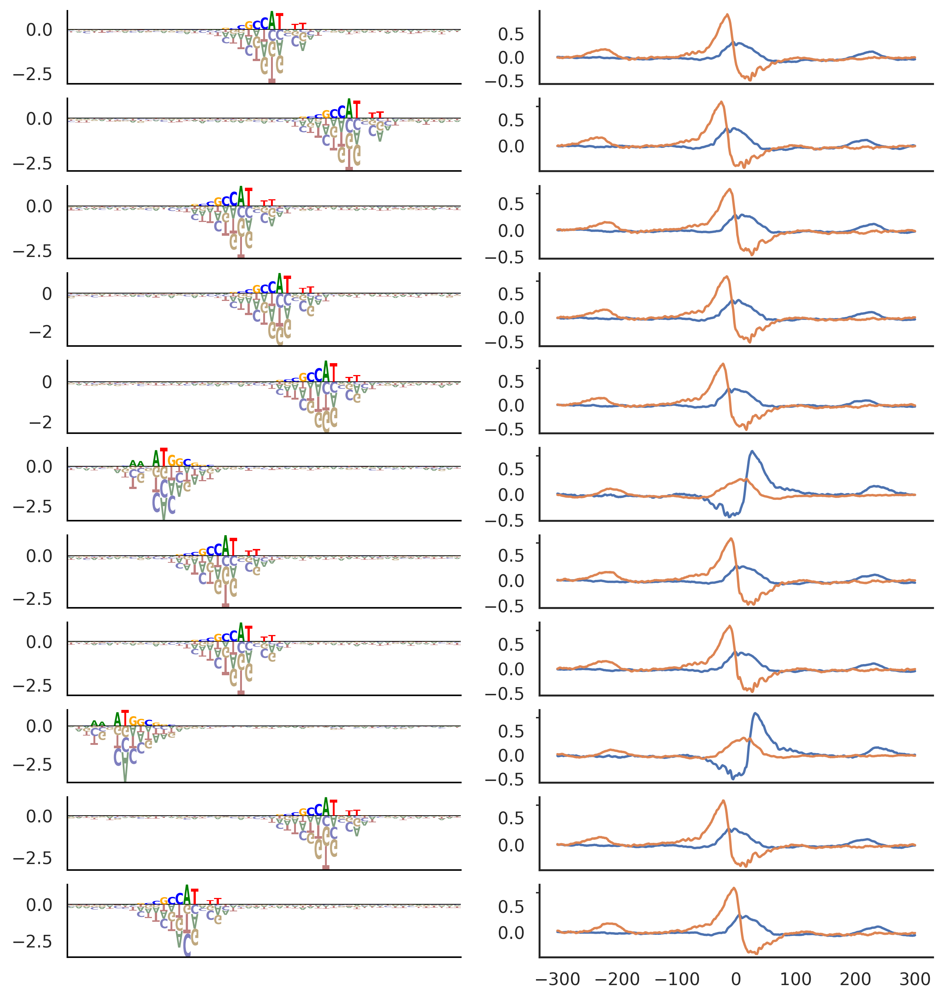

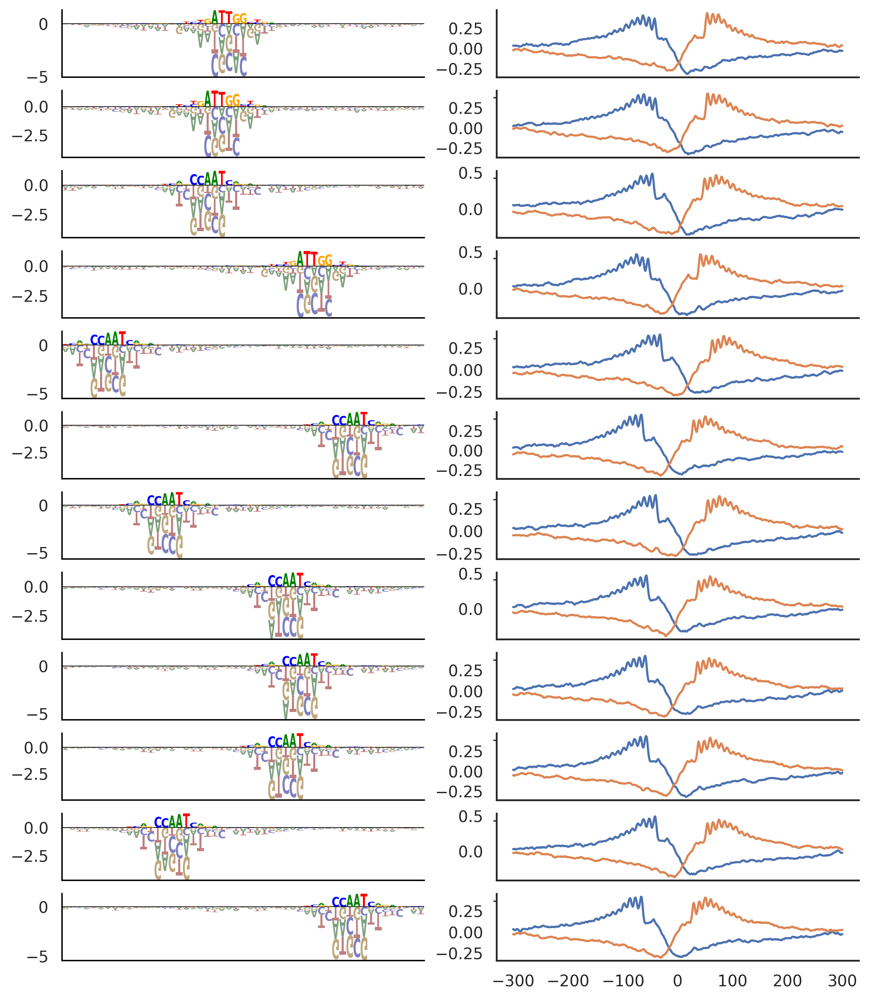

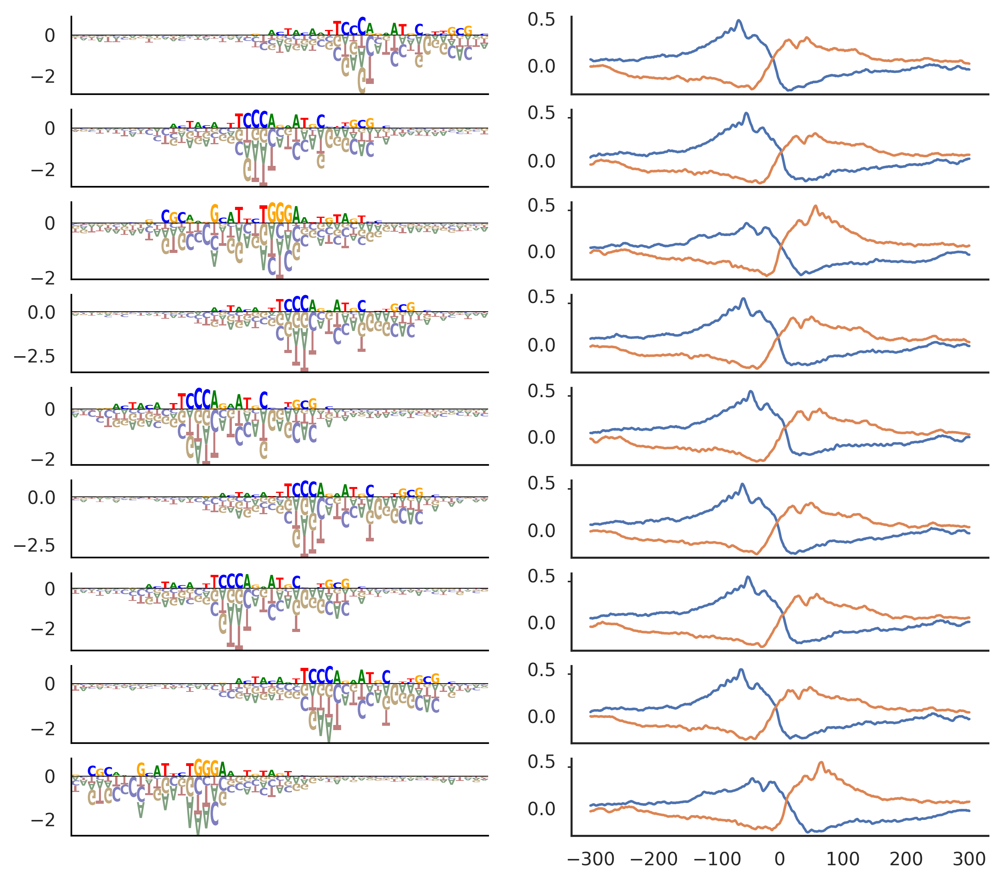

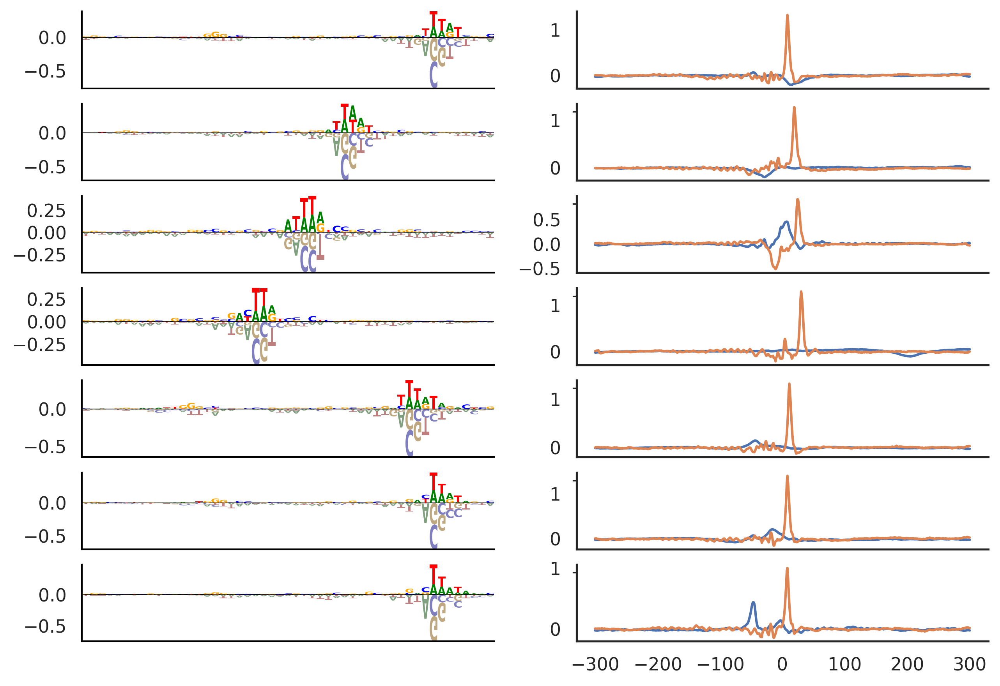

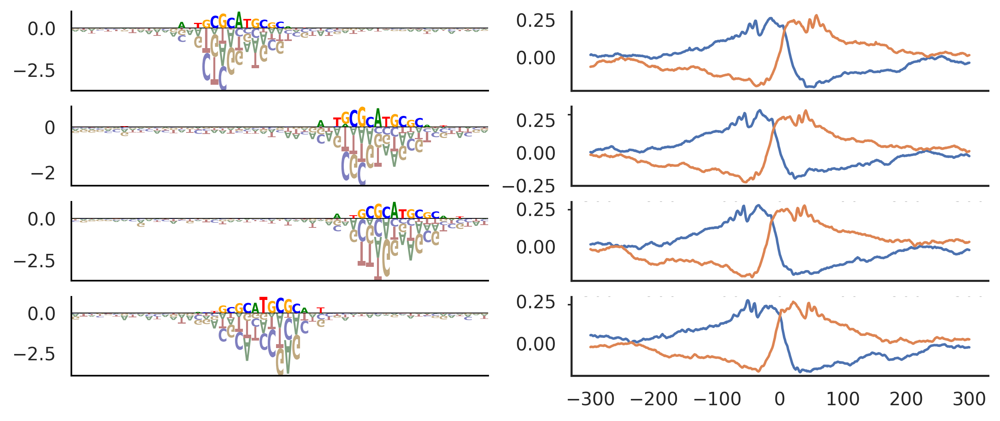

...

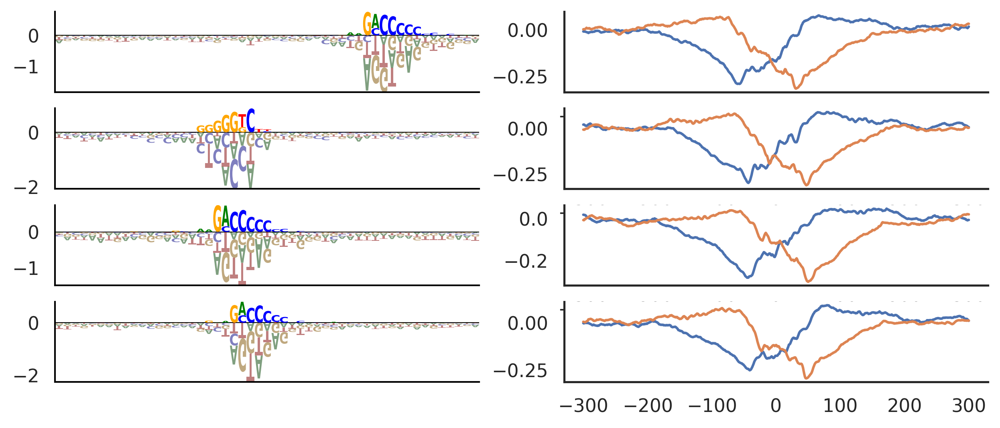

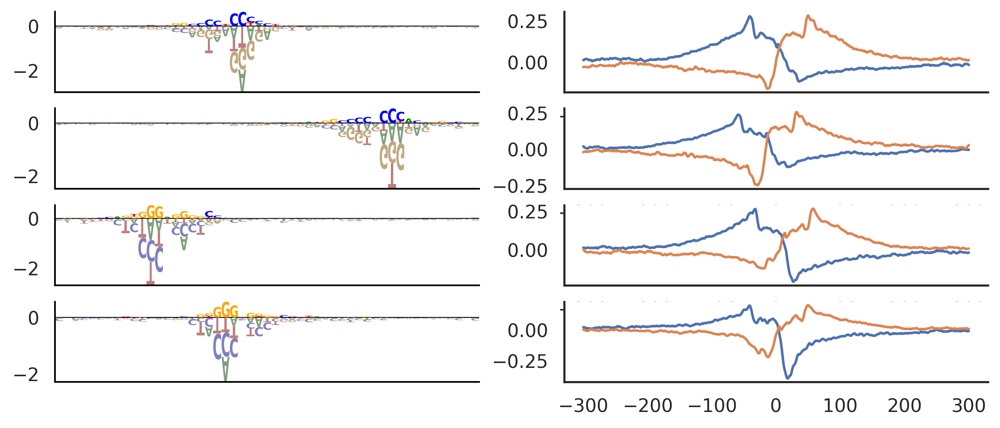

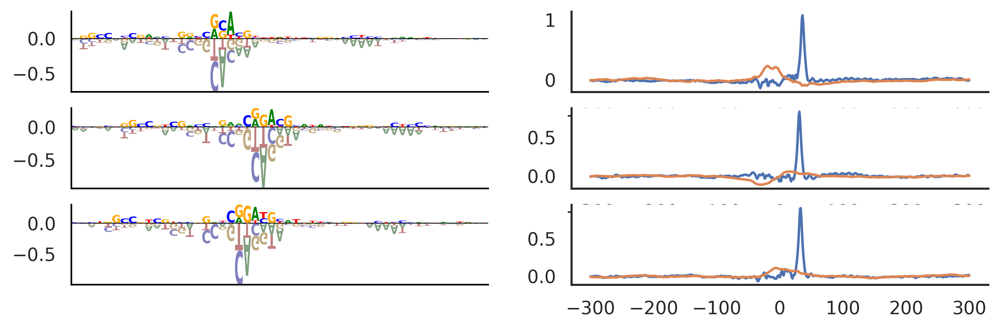

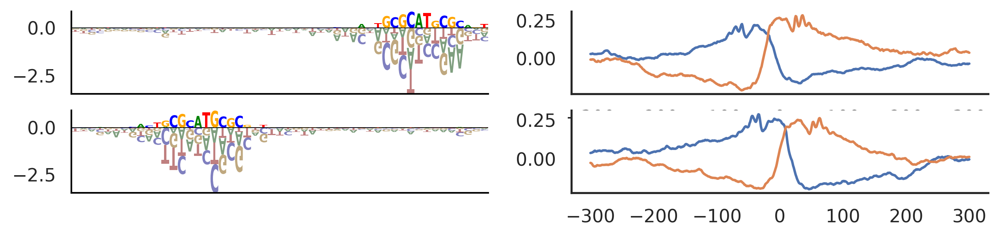

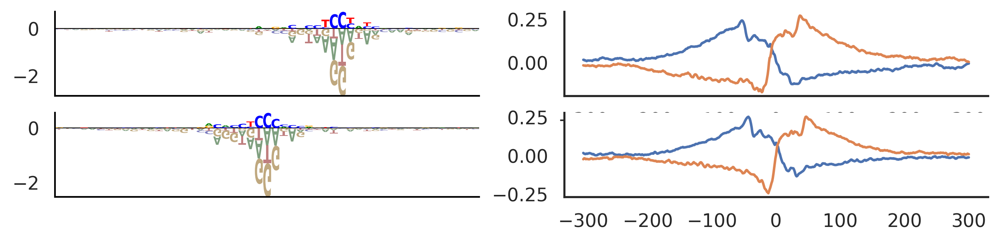

In [17]:
from matplotlib.backends.backend_pdf import PdfPages
bestmats = []
bestscores = []
filescores = defaultdict(list)
with PdfPages('../figures/motif_replicates.pdf') as pdf:

    for cc in list(nx.connected_components(g)):
        bestscore = 0
        matinds = []
        motifinds = []
        scores = []

        _, axes = plt.subplots( figsize=(10,len(cc)*1), nrows=len(cc),ncols=2, dpi=300)
        for i in cc:
            motifind, matind = list(map(int, i.split('_')))
            score = np.sum([crossmats[i,matind][:,motifind].max() if i < matind else crossmats[matind,i][motifind,:].max() for i in np.setdiff1d(range(4),[matind])  ])

            if score > bestscore:
                bestmat = mats[matind][motifind]

            matinds.append(matind)
            motifinds.append(motifind)
            scores.append(score)

            filescores[filenames[matind]].append(score)

        for ii, i in enumerate(np.argsort(-np.array(scores))):
            plotfun(mats[matinds[i]][motifinds[i]].T, ax=axes[ii][0])
            axes[ii][0].set_xticks([])
            axes[ii][1].plot(np.arange(-300,301), demats[matinds[i]][0,motifinds[i]])
            axes[ii][1].plot(np.arange(-300,301), demats[matinds[i]][0,40+motifinds[i],::-1])
            sns.despine()
        pdf.savefig()
        bestscores.append(bestscores)
        bestmats.append(bestmat)



In [9]:
selectmats = []
selectdemats = []
selectdemats_rc = []

for cc in list(nx.connected_components(g)):
    if len(cc)>=7:
        for i in cc:
            motifind, matind = list(map(int, i.split('_')))

            if matind == 7:
                selectmats.append(mats[matind][motifind])
                selectdemats.append(demats[matind][:,[motifind],:])
                selectdemats_rc.append(demats[matind][:,[motifind+40],:])


In [10]:
len(selectmats)

6

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

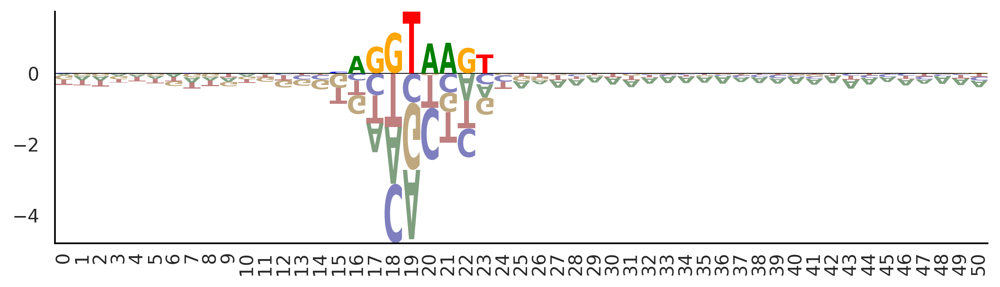

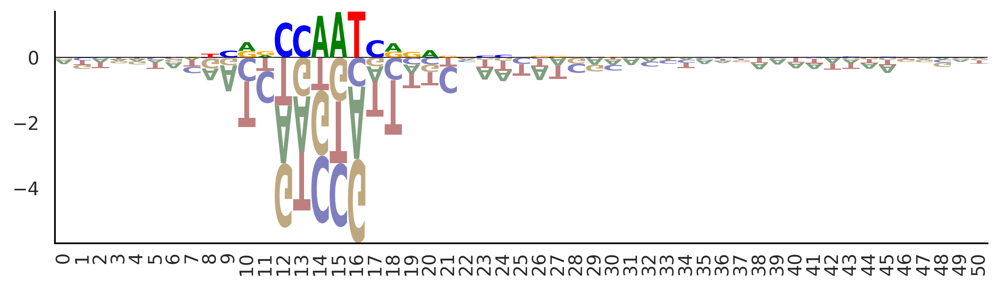

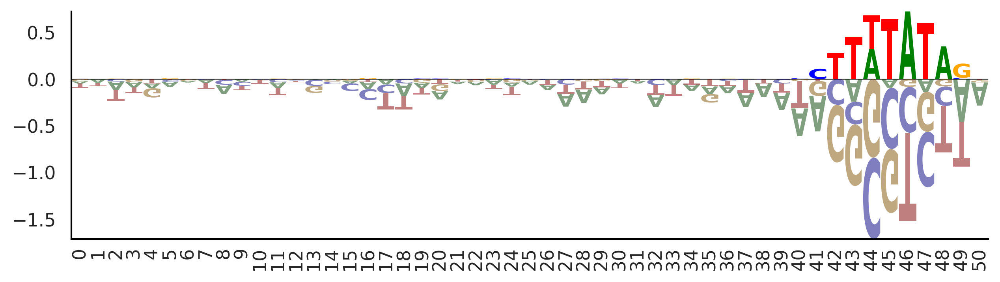

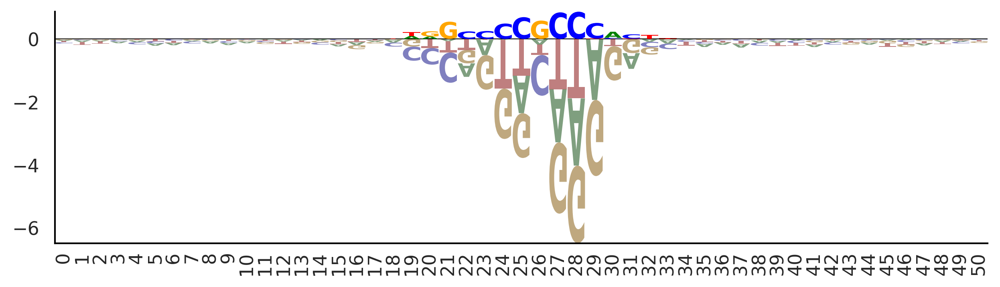

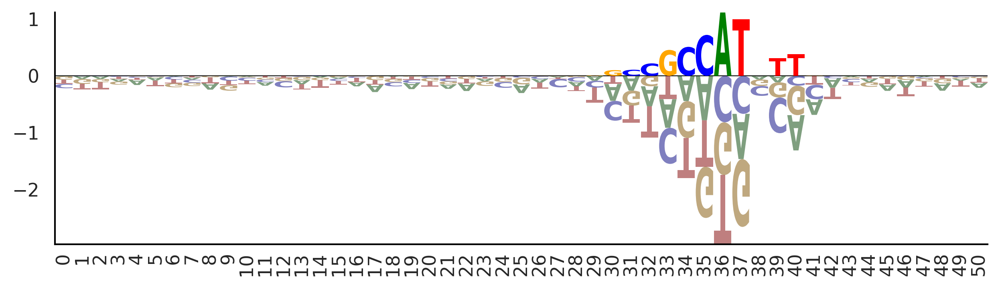

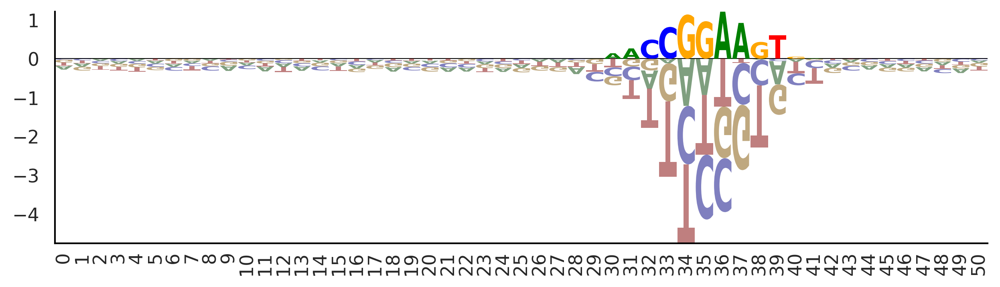

In [17]:
for mat in selectmats:
    plotfun(mat.T)

In [18]:
np.save(arr=np.stack(selectmats)[np.array([0, 1, 3, 4, 5, 2]),:], 
        file='./models/stage1_40000_7.selectmotifs0.95.10motifs.conv.npy')
np.save(arr=np.concatenate([np.concatenate(selectdemats, axis=1)[:,np.array([0, 1, 3, 4, 5, 2]),:],
                np.concatenate(selectdemats_rc, axis=1)[:,np.array([0, 1, 3, 4, 5, 2]),:]], axis=1),
        file='./models/stage1_40000_7.selectmotifs0.95.10motifs.deconv.npy')


In [19]:
mats = [nets[i].conv_inr.weight.detach().numpy() for i in range(len(nets))]
mats_norm = [mat - mat.mean(axis=1, keepdims=True) for mat in mats]
demats = [nets[i].deconv_inr.weight.detach().numpy() for i in range(len(nets))]

In [20]:
from scipy.signal import correlate2d
from matplotlib import pyplot as plt
%matplotlib inline
crossmats = {}
validmats = {}
for ii in range(len(mats)):
    for jj in range(ii+1, len(mats)):
        cors = []
        for i in range(10):
            cors_row = []
            for j in range(10):
                cors_row.append(cross_corr(mats_norm[ii][i], mats_norm[jj][j]).max())
            cors.append(cors_row)
        cors = np.array(cors)
        crossmats[(ii,jj)]=cors
        validmats[(ii,jj)]= (np.abs(mats_norm[ii]).max(axis=2).max(axis=1)[:,None]>0.1) & (np.abs(mats_norm[jj]).max(axis=2).max(axis=1)[None,:]>0.1)
        

In [21]:
matchlist = []
matchscores = []
for i in range(len(nets)):
    for j in range(i+1, len(nets)):
        mat = crossmats[(i, j)].copy()
        mat[mat < mat.max(axis=1, keepdims=True)] = 0
        mat[mat < mat.max(axis=0, keepdims=True)] = 0
        mat[~validmats[(i, j)]] = 0
        # Changed np.object to object here
        matchlist.append(np.argwhere(mat > 0.95).astype(str) + np.array(["_"+str(i), "_"+str(j)], dtype=object)[None, :])
        matchscores.append(mat[mat > 0.95])

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.


findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

{'7_11', '3_0', '5_6'}


findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

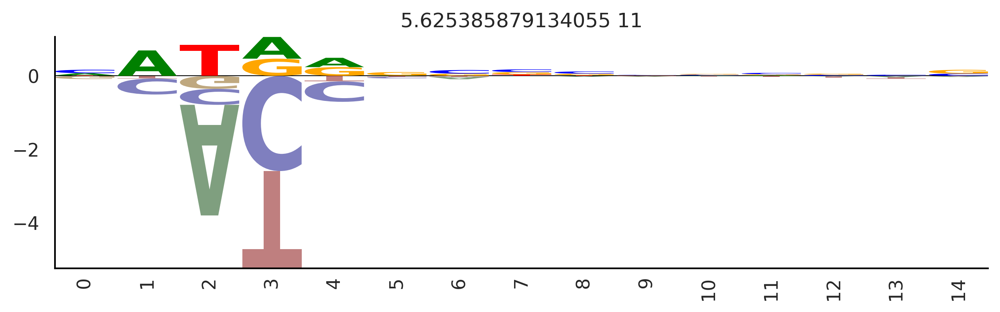

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

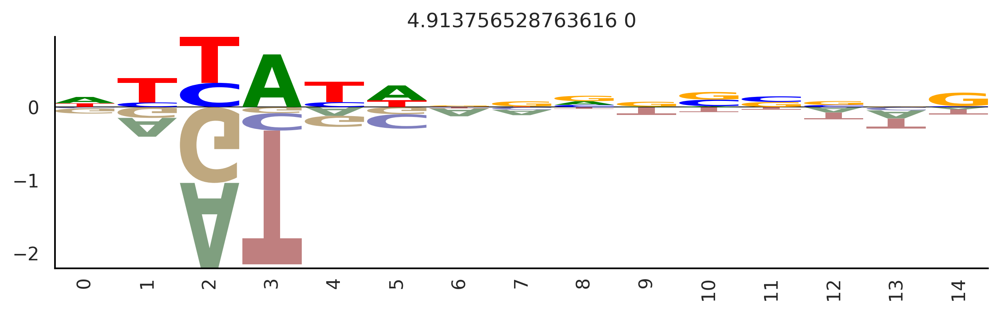

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

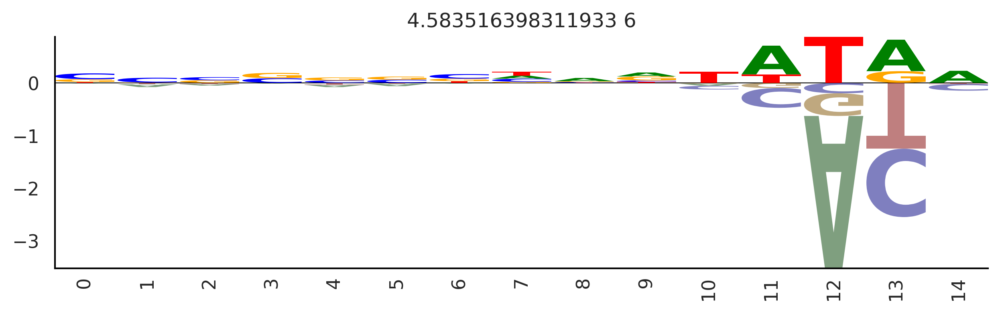

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

{'1_1', '6_5'}


findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

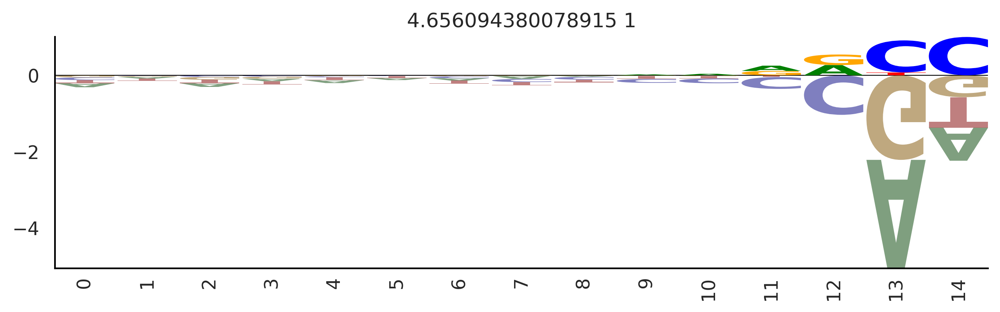

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

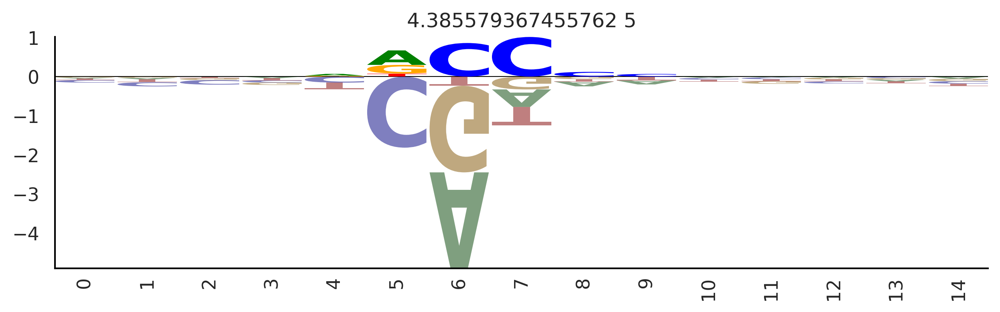

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

{'5_1', '9_6', '2_5'}


findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

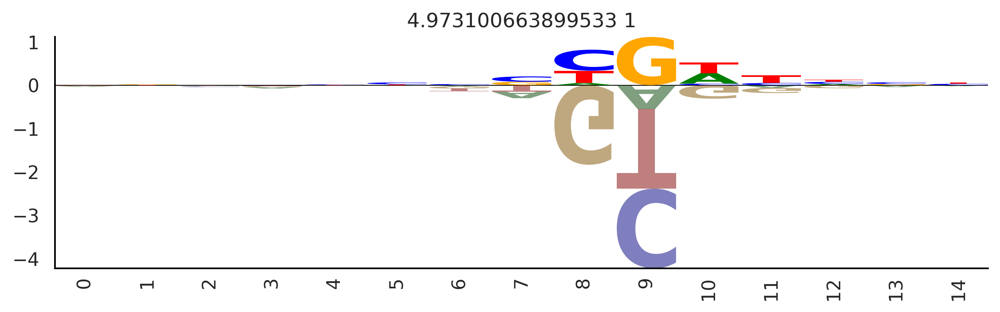

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

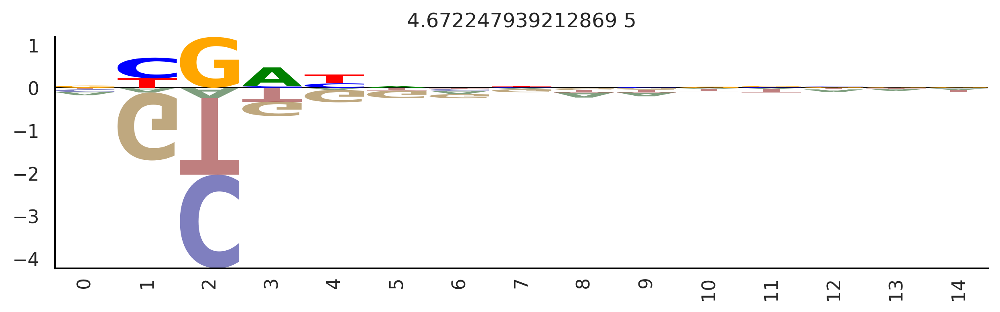

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

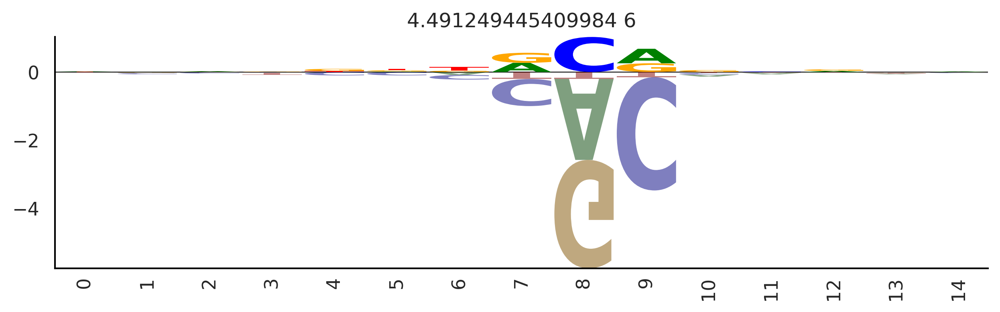

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

{'4_6', '2_2'}


findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

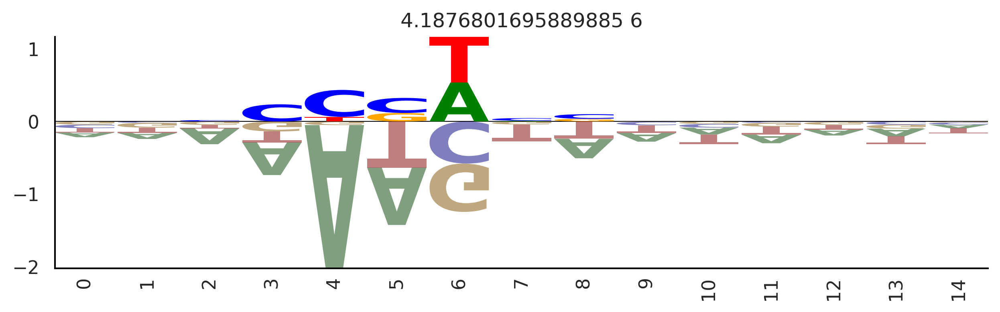

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

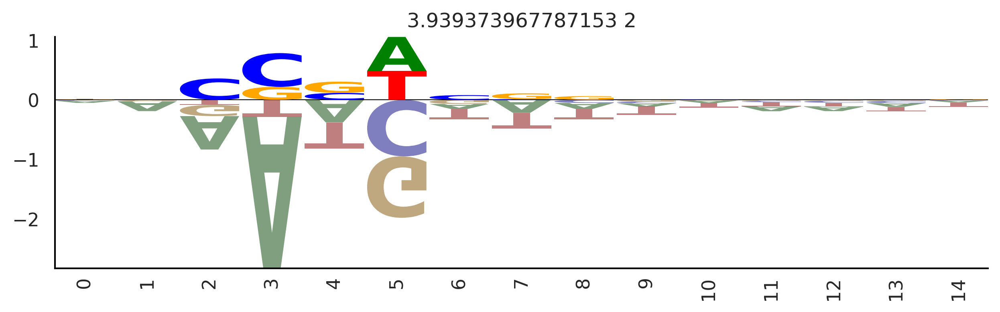

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

{'4_11', '7_9', '0_5', '6_4', '6_3', '0_10'}


findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

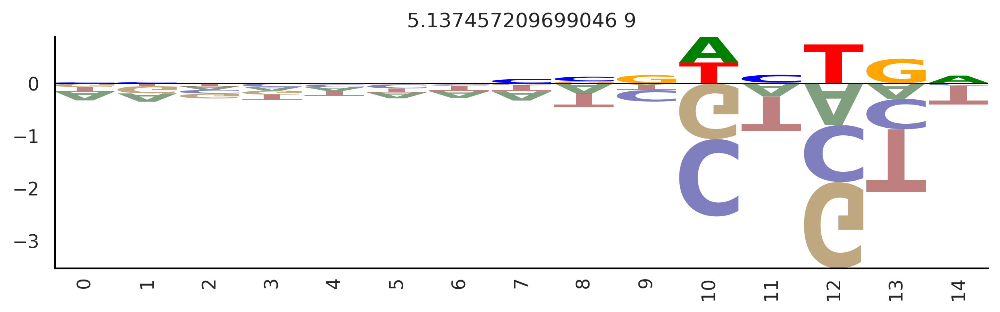

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

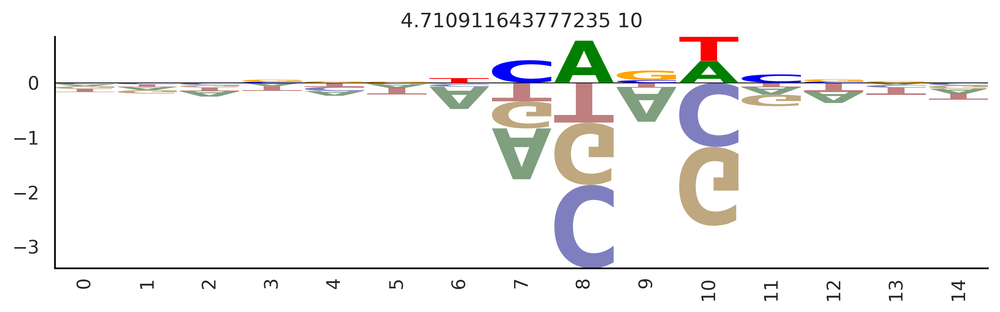

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

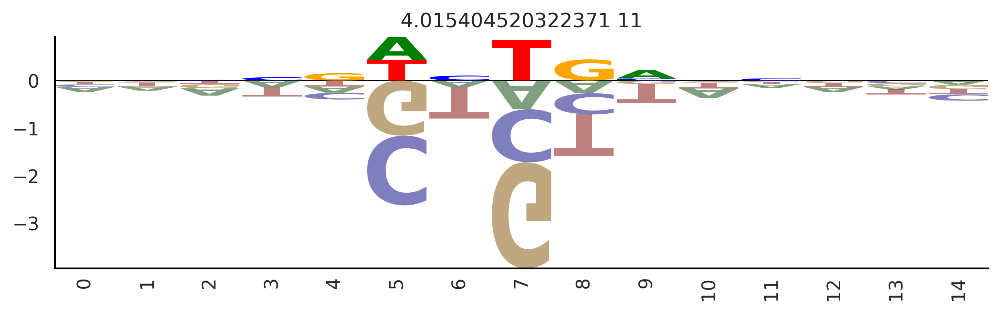

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

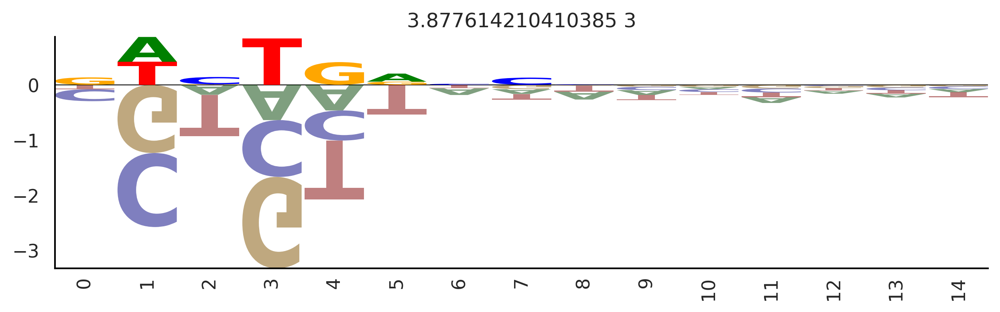

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

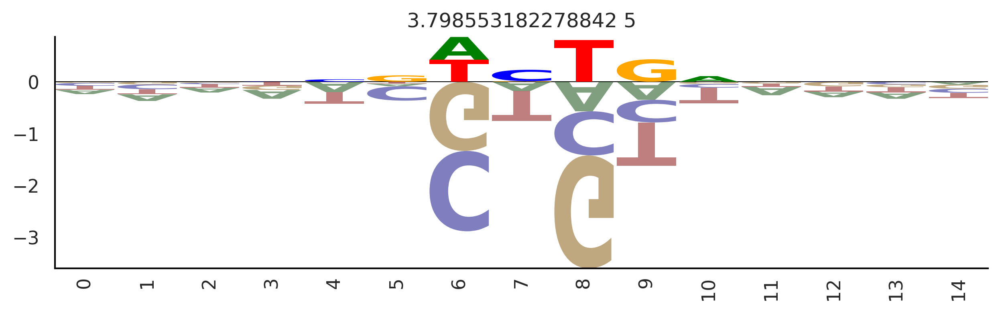

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

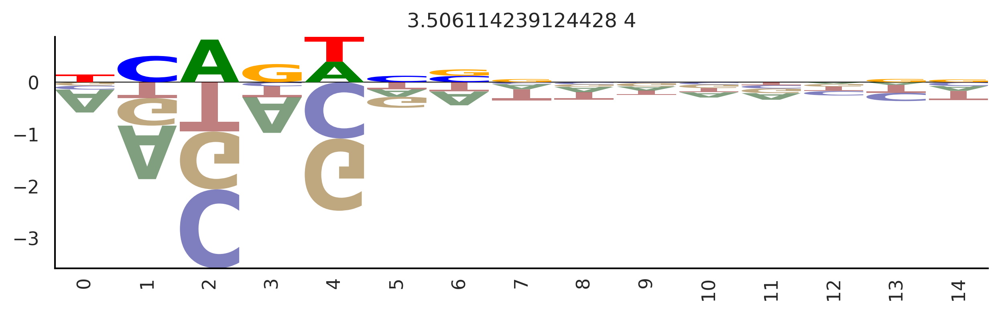

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

{'7_7', '7_10', '9_8', '2_9'}


findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

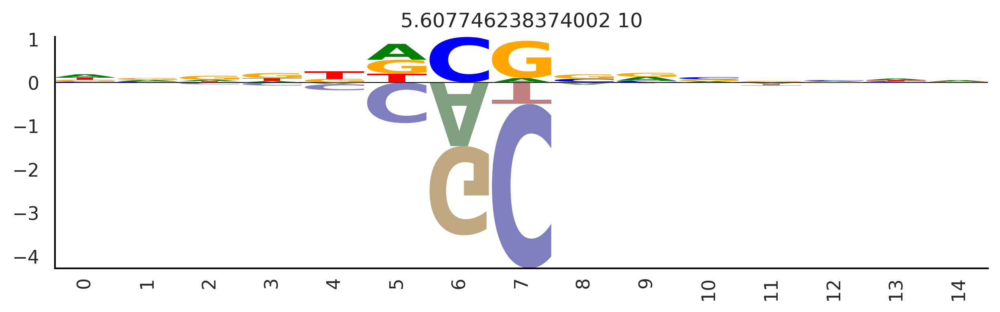

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

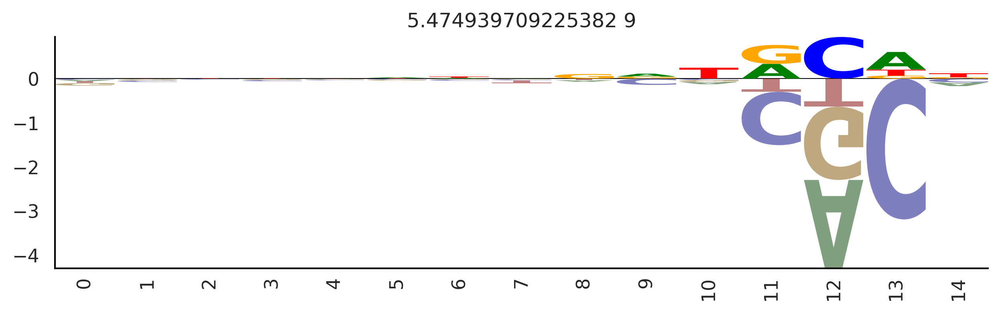

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

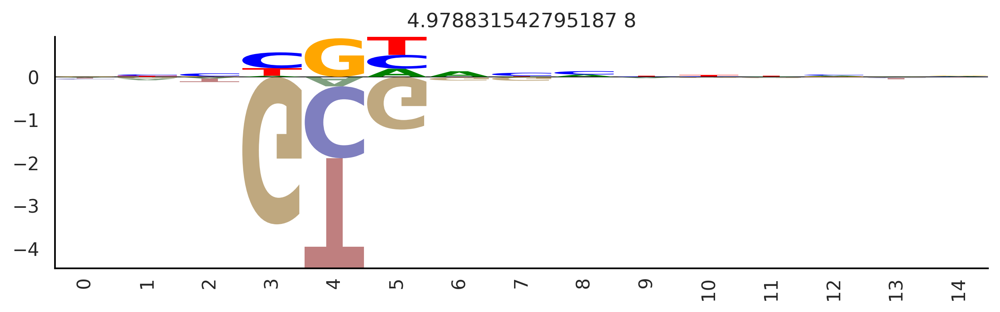

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

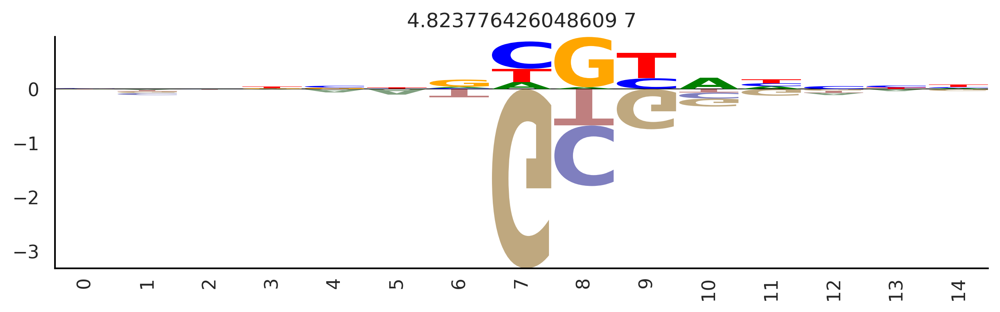

In [23]:
import networkx as nx
from collections import defaultdict
g = nx.Graph()
g.add_weighted_edges_from(np.hstack([np.concatenate(matchlist, axis=0),np.concatenate(matchscores)[:,None]]))

bestmats = []
bestdemats = []
bestdemats_rc = []
bestscores = []
for cc in list(nx.connected_components(g)):
    print(cc)
    bestscore = 0
    matinds = []
    motifinds = []
    scores = []
    for i in cc:
        motifind, matind = list(map(int, i.split('_')))
        score = np.sum([crossmats[i,matind][:,motifind].max() if i < matind else crossmats[matind,i][motifind,:].max() for i in np.setdiff1d(range(7),[matind])  ]
)
        if score > bestscore:
            bestmat = mats[matind][motifind]
            bestdemat = demats[matind][[motifind],:,:]
            bestdemat_rc = demats[matind][[motifind+10],:,:]
            bestscore = score
        matinds.append(matind)
        motifinds.append(motifind)
        scores.append(score)


    for i in np.argsort(-np.array(scores)):
        plotfun(mats[matinds[i]][motifinds[i]].T, title=str(scores[i])+' '+ str(matinds[i]))
        plt.show()
    bestscores.append(bestscores)
    bestmats.append(bestmat)
    bestdemats.append(bestdemat)
    bestdemats_rc.append(bestdemat_rc)



In [24]:
np.save(arr=np.stack(bestmats)[[0,1,2]], file='./models/stage1_40000.selectinrs0.95.3inrf.npy')
np.save(arr=np.concatenate([np.concatenate(bestdemats, axis=0)[[0,1,2],:,:],
                            np.concatenate(bestdemats_rc, axis=0)[[0,1,2],:,:]], axis=0), file='./models/stage1_40000.selectinrs0.95.3inrf.deconv.npy')


In [ ]:
bestmats = np.load( file='stage1_40000.selectinrs0.95.3inrf.npy')

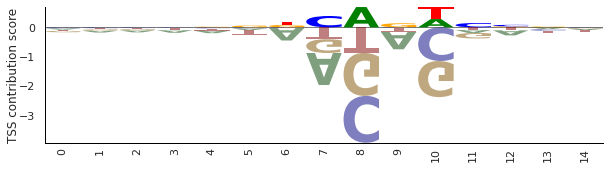

In [ ]:
plotfun(bestmats[0].T)

Center and trim stage 2 model sequence patterns

In [1]:
import numpy as np
from copy import deepcopy

import torch

from torch import nn
from torch.autograd import grad
from torch_fftconv import fft_conv1d, FFTConv1d

class SimpleNet(nn.Module):
    def __init__(self):
        super(SimpleNet, self).__init__()
        self.conv = nn.Conv1d(4,  n_motifs, kernel_size=51, padding=25)
        self.conv_inr = nn.Conv1d(4,  10, kernel_size=15, padding=7)
        self.conv_sim = nn.Conv1d(4,  32, kernel_size=3, padding=1)

        self.activation = nn.ReLU()

        self.deconv = FFTConv1d(n_motifs*2,  10, kernel_size=601, padding=300)
        self.deconv_inr = nn.ConvTranspose1d(20,  10, kernel_size=15, padding=7)
        self.deconv_sim = FFTConv1d(64,  10, kernel_size=601, padding=300)

        self.sigmoid = nn.Sigmoid()
        self.softplus = nn.Softplus()
        self.scaler = nn.Parameter(torch.ones(1))
        self.scaler2 = nn.Parameter(torch.ones(1))

    def forward(self, x, withscaler=True):
        y = torch.cat([self.conv(x), self.conv(x.flip([1,2])).flip([2])], 1)
        y_inr = torch.cat([self.conv_inr(x), self.conv_inr(x.flip([1,2])).flip([2])], 1)
        y_sim = torch.cat([self.conv_sim(x), self.conv_sim(x.flip([1,2])).flip([2])], 1)

        if withscaler:
            yact = self.softplus(y*self.scaler**2)
            y_inr_act = self.softplus(y_inr)
            y_sim_act = self.softplus(y_sim*self.scaler2**2)#*y_sim
        else:
            yact = self.softplus(y)
            y_inr_act = self.softplus(y_inr)
            y_sim_act = self.softplus(y_sim)#*y_sim

        y_pred = self.softplus(self.deconv(yact)+self.deconv_inr(y_inr_act)+self.deconv_sim(y_sim_act))
        return y_pred
    
n_motifs=6
net = SimpleNet()
net.load_state_dict(torch.load('models/stage2_40000_3.pth', map_location='cpu'))


/project2/yangili1/yhsz5566/mambaforge/envs/puffin/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


<All keys matched successfully>

In [2]:
mats = net.conv.weight.detach().numpy()
demats = net.deconv.weight.detach().numpy()

In [3]:
selectmats = []
selectdemats = []
selectdemats_rc = []

for i in range(len(mats)):
    selectmats.append(mats[i])
    selectdemats.append(demats[:,[i],:])
    selectdemats_rc.append(demats[:,[i+6],:])


findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.


findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

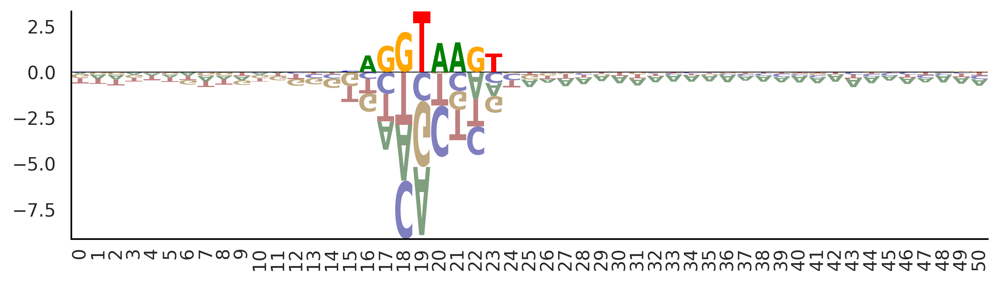

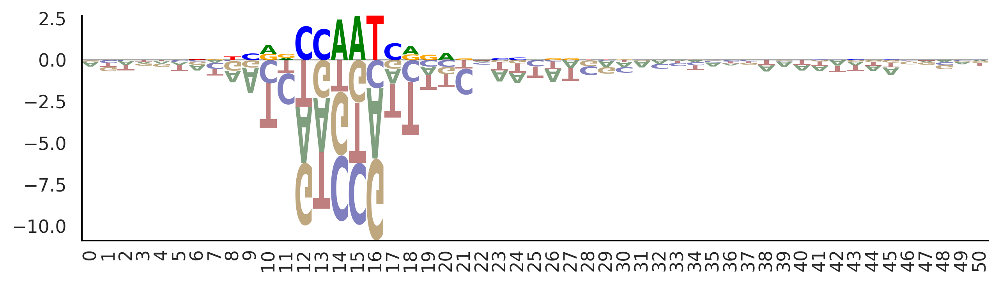

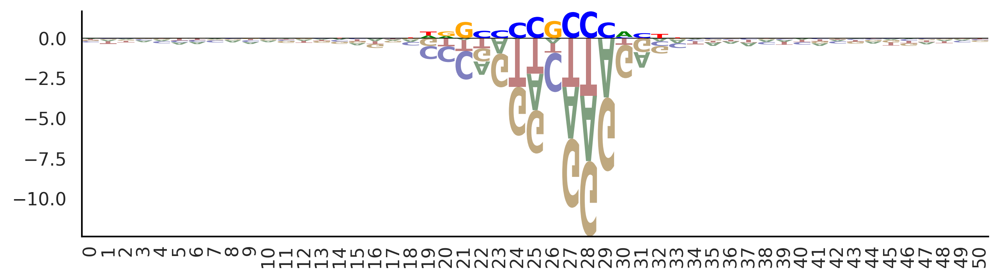

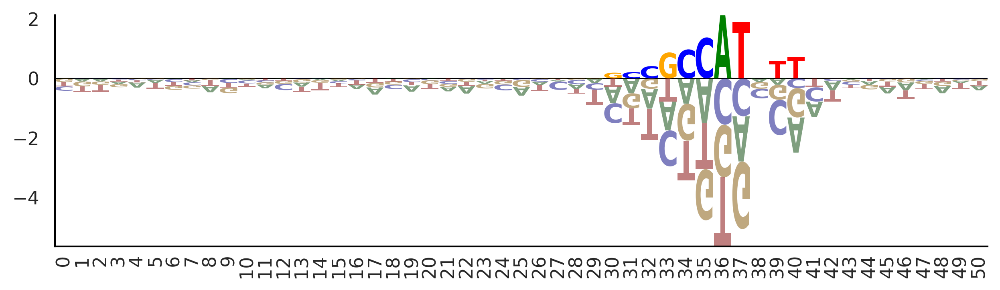

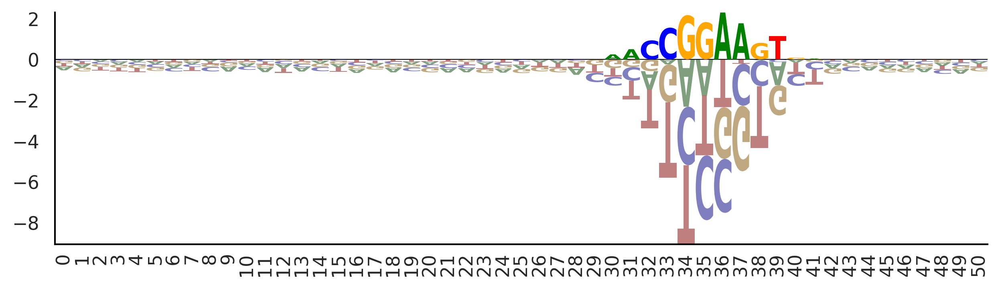

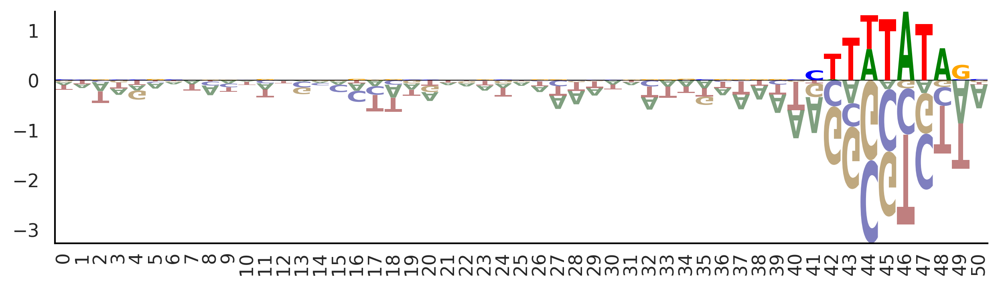

In [6]:
for mat in selectmats:
    plotfun(mat.T)

In [7]:
offsets = []
for i in range(len(selectmats)):
    offset = 25 - np.round((np.arange(51) * np.square((selectmats[i] - selectmats[i].mean(axis=0))).sum(axis=0)).sum()/  np.square((selectmats[i] - selectmats[i].mean(axis=0))).sum(axis=0).sum())
    offsets.append(offset)
print(offsets)

[6.0, 10.0, -2.0, -11.0, -10.0, -19.0]


In [9]:
#with manual adjustment to centering offsets
for i, offset in zip(range(len(selectmats)), [12.0, -2.0, 8.0, 1.0, -16.0, -11.0, 0, 1.0, -9.0, 17.0]):
    print(offset)
    if offset > 0:
        selectmats[i][ :, int(offset):] = selectmats[i][:, :-int(offset)]
        selectmats[i][ :, :int(offset)] = 0
        selectdemats[i][ :, :,int(offset):] = selectdemats[i][:, :,:-int(offset)]
        selectdemats[i][ :, :,:int(offset)] = 0
        selectdemats_rc[i][ :, :, int(offset):] = selectdemats_rc[i][:, :, :-int(offset)]
        selectdemats_rc[i][ :, :,:int(offset)] = 0
    elif offset < 0:
        selectmats[i][:, :-int(np.abs(offset))] = selectmats[i][:, int(np.abs(offset)):]
        selectmats[i][:, -int(np.abs(offset)):] = 0
        selectdemats[i][:,:, :-int(np.abs(offset))] = selectdemats[i][:, :, int(np.abs(offset)):]
        selectdemats[i][:,:, -int(np.abs(offset)):] = 0
        selectdemats_rc[i][:,:, :-int(np.abs(offset))] = selectdemats_rc[i][:, :, int(np.abs(offset)):]
        selectdemats_rc[i][:,:, -int(np.abs(offset)):] = 0

12.0
-2.0
8.0
1.0
-16.0
-11.0


In [16]:
np.save(arr=np.stack(selectmats), file='models/stage2_40000_3.centered.npy')
np.save(arr=np.concatenate([np.concatenate(selectdemats, axis=1),
                np.concatenate(selectdemats_rc, axis=1)], axis=1),
        file='models/stage2_40000_3.centered.deconv.npy')


findfont: Font family 'Arial Rounded MT Bold' not found.


findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

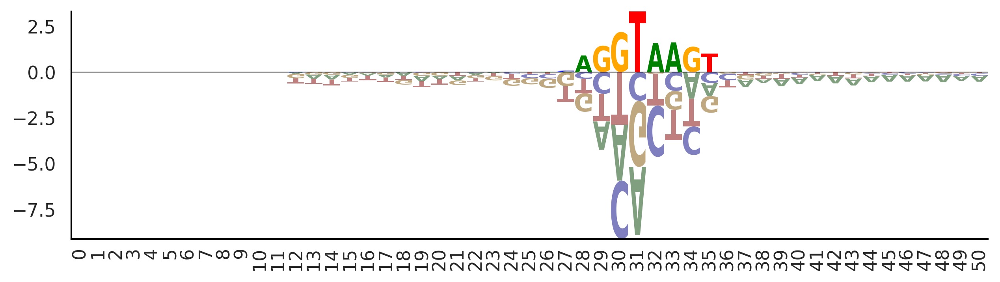

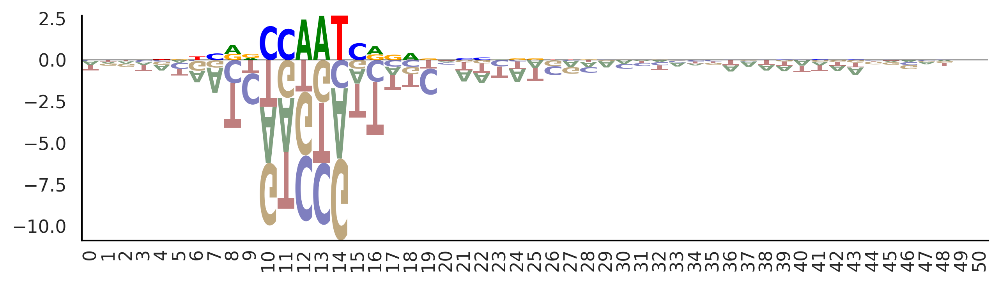

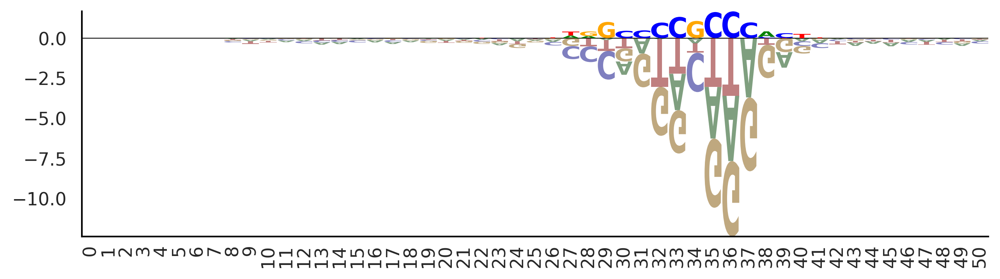

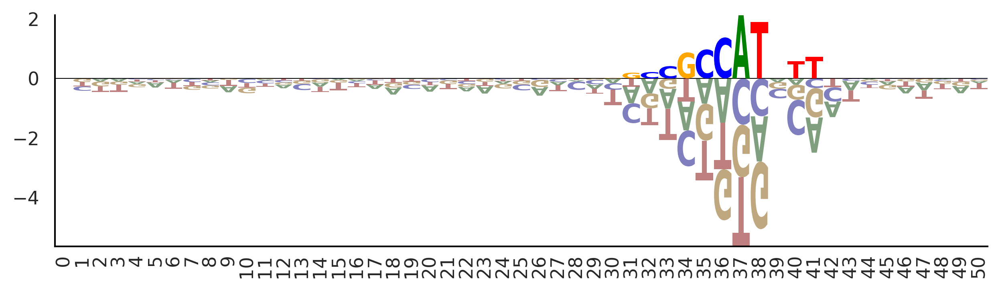

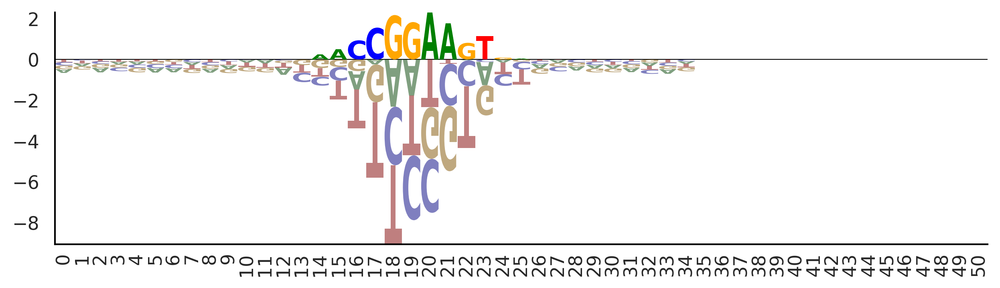

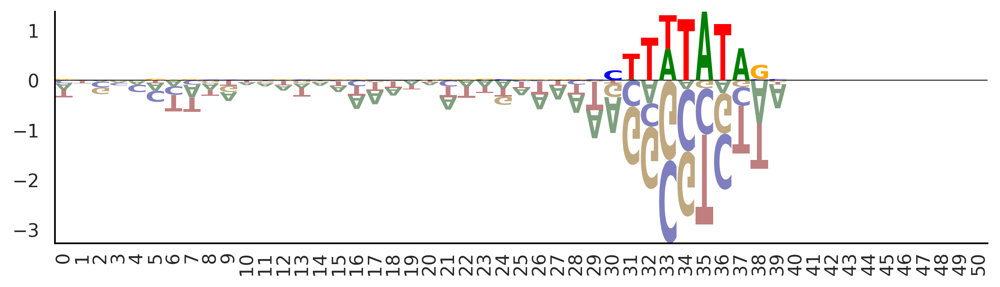

In [13]:
for mat in selectmats:
    plotfun(mat.T)

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Rounded MT Bold' not found.
findfont: Font family 'Arial Ro

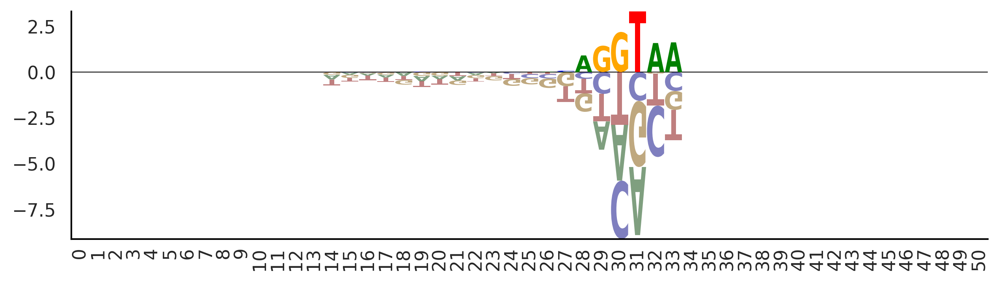

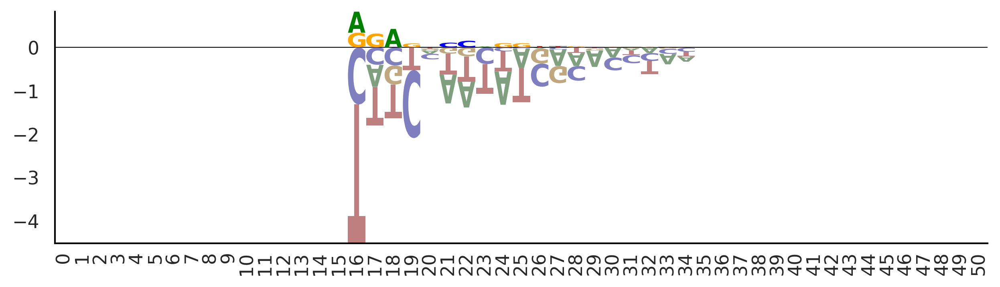

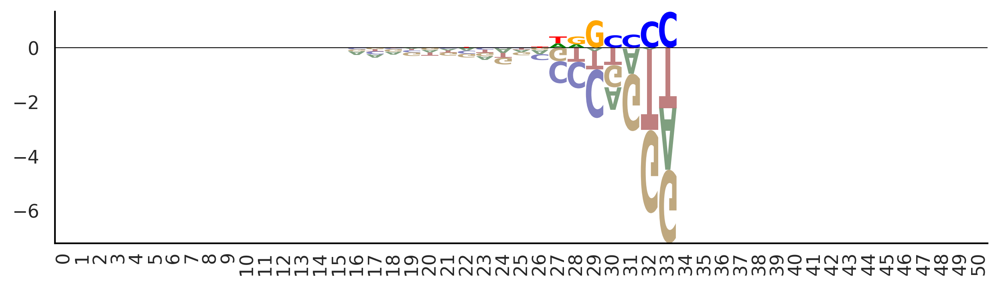

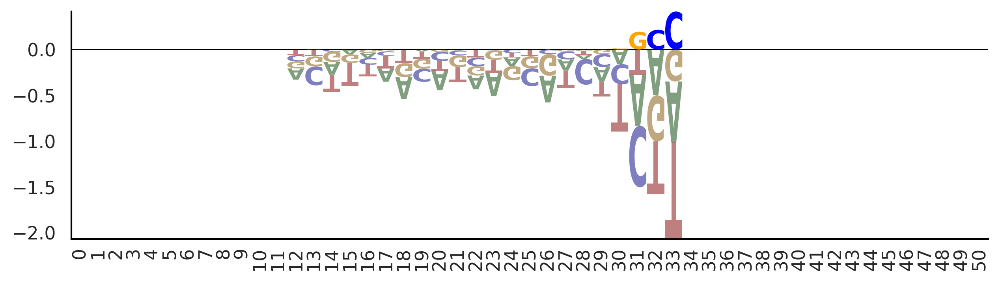

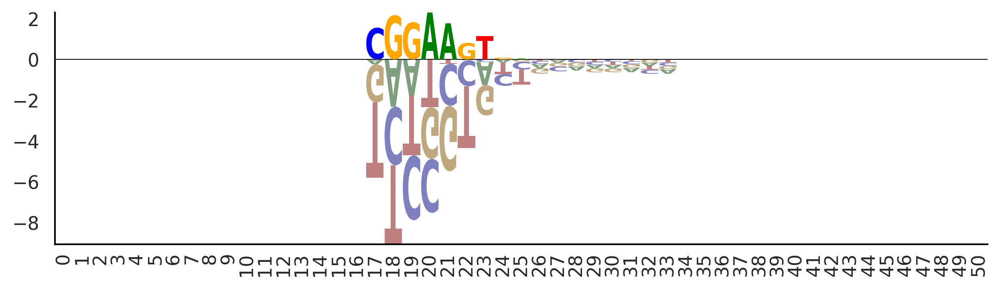

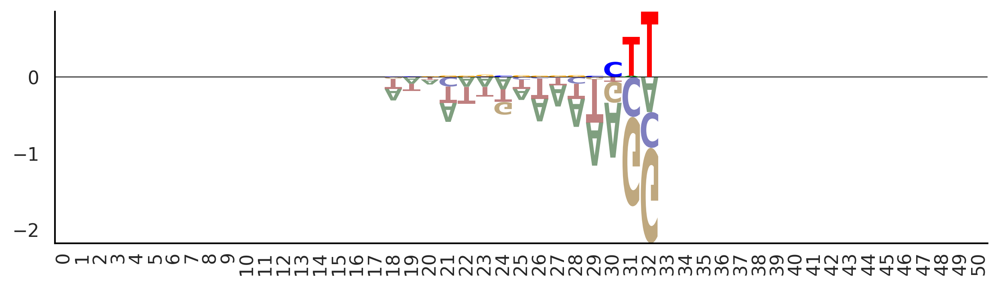

In [ ]:
cutoffs = [[14,34], [16,35],[16,34],[12,34],[17,34],[18,33],[0,51],[13,35], [11,42], [17,33]]
 
for m, (l,r) in zip(selectmats, cutoffs):
    m[:,:l]=0
    m[:,r:]=0
for mat in selectmats:
    plotfun(mat.T)

In [15]:
np.save(arr=np.stack(selectmats), file='models/stage2_40000_3.centered.cut.npy')


## Evaluation of stage 2 models

In [8]:
# Load the model architecture
class SimpleNet(nn.Module):
    def __init__(self, n_motifs):
        super(SimpleNet, self).__init__()
        self.conv = nn.Conv1d(4, n_motifs, kernel_size=51, padding=25)
        self.conv_inr = nn.Conv1d(4, 10, kernel_size=15, padding=7)
        self.conv_sim = nn.Conv1d(4, 32, kernel_size=3, padding=1)
        self.activation = nn.ReLU()

        self.deconv = FFTConv1d(n_motifs * 2, 10, kernel_size=601, padding=300)
        self.deconv_inr = nn.ConvTranspose1d(20, 10, kernel_size=15, padding=7)
        self.deconv_sim = FFTConv1d(64, 10, kernel_size=601, padding=300)
        self.sigmoid = nn.Sigmoid()
        self.softplus = nn.Softplus()
        self.scaler = nn.Parameter(torch.ones(1))
        self.scaler2 = nn.Parameter(torch.ones(1))

    def forward(self, x, withscaler=True):
        y = torch.cat([self.conv(x), self.conv(x.flip([1, 2])).flip([2])], 1)
        y_inr = torch.cat([self.conv_inr(x), self.conv_inr(x.flip([1, 2])).flip([2])], 1)
        y_sim = torch.cat([self.conv_sim(x), self.conv_sim(x.flip([1, 2])).flip([2])], 1)

        if withscaler:
            yact = self.softplus(y * self.scaler**2)
            y_inr_act = self.softplus(y_inr)
            y_sim_act = self.softplus(y_sim * self.scaler2**2)
        else:
            yact = self.softplus(y)
            y_inr_act = self.softplus(y_inr)
            y_sim_act = self.softplus(y_sim)
            
        y_pred = self.softplus(
            self.deconv(yact) + self.deconv_inr(y_inr_act) + self.deconv_sim(y_sim_act)
        return y_pred

def load_model(model_path, n_motifs, motifs, motifs_deconv, inrs, inrs_deconv):
    """Load the trained model with weights"""
    model = SimpleNet(n_motifs).cuda()
    
    # Load saved weights
    state_dict = torch.load(model_path)
    model.load_state_dict(state_dict)
    
    # Set initial motif weights (as done in training)
    with torch.no_grad():
        model.conv.weight.data = torch.FloatTensor(motifs).cuda()
        model.deconv.weight.data = torch.FloatTensor(motifs_deconv).cuda()
        model.deconv_inr.weight.data[:3, :, :] = torch.FloatTensor(inrs_deconv[:3, :, :]).cuda()
        model.deconv_inr.weight.data[10:13, :, :] = torch.FloatTensor(inrs_deconv[3:, :, :]).cuda()
        model.conv_inr.weight.data[:3, :, :] = torch.FloatTensor(inrs).cuda()
    
    model.eval()
    return model

def evaluate_model(model, test_seqs, test_tars, batch_size=64):
    """Evaluate model on test data"""
    predictions = []
    targets = []
    
    with torch.no_grad():
        for j in range(0, test_seqs.shape[0], batch_size):
            # Get batch
            sequence = test_seqs[j:j+batch_size, :, :]
            target = test_tars[j:j+batch_size, :, :]
            
            # Convert to tensor
            sequence = torch.FloatTensor(sequence).cuda()
            target = torch.FloatTensor(target).cuda()
            
            # Predict
            pred = model(sequence, withscaler=False)
            
            # Store results
            predictions.append(pred.cpu().numpy())
            targets.append(target.cpu().numpy())
    
    # Concatenate all batches
    predictions = np.concatenate(predictions, axis=0)
    targets = np.concatenate(targets, axis=0)
    
    return predictions, targets

def calculate_metrics(predictions, targets, feature_names):
    """Calculate evaluation metrics for each feature"""
    metrics = {
        'feature': [],
        'pearson_r': [],
        'spearman_r': [],
        'r2_score': [],
        'mse': []
    }
    
    # Trim edges as done during training
    pred_trimmed = predictions[:, :, 325:-325]
    target_trimmed = targets[:, :, 325:-325]
    
    # Calculate metrics for each feature
    for i, name in enumerate(feature_names):
        # Flatten predictions and targets for this feature
        pred_flat = pred_trimmed[:, i, :].flatten()
        target_flat = target_trimmed[:, i, :].flatten()
        
        # Calculate metrics
        pearson = pearsonr(pred_flat, target_flat)[0]
        spearman = spearmanr(pred_flat, target_flat)[0]
        r2 = r2_score(target_flat, pred_flat)
        mse = np.mean((pred_flat - target_flat)**2)
        
        # Store results
        metrics['feature'].append(name)
        metrics['pearson_r'].append(pearson)
        metrics['spearman_r'].append(spearman)
        metrics['r2_score'].append(r2)
        metrics['mse'].append(mse)
    
    return pd.DataFrame(metrics)

def plot_predictions_vs_targets(predictions, targets, feature_names, n_examples=5):
    """Plot predictions vs targets for visualization"""
    # Trim edges as done during training
    pred_trimmed = predictions[:, :, 325:-325]
    target_trimmed = targets[:, :, 325:-325]
    
    # Plot for each feature
    for feature_idx, name in enumerate(feature_names):
        plt.figure(figsize=(15, 3*n_examples))
        plt.suptitle(f'Predictions vs Targets - {name}', y=1.02)
        
        # Plot random examples
        example_indices = np.random.choice(pred_trimmed.shape[0], n_examples, replace=False)
        
        for i, idx in enumerate(example_indices):
            plt.subplot(n_examples, 1, i+1)
            plt.plot(target_trimmed[idx, feature_idx, :], label='Target', alpha=0.7)
            plt.plot(pred_trimmed[idx, feature_idx, :], label='Prediction', alpha=0.7)
            plt.legend()
            plt.ylabel('Signal')
        
        plt.xlabel('Position')
        plt.tight_layout()
        plt.savefig(f'prediction_vs_target_{name}.png', bbox_inches='tight', dpi=300)
        plt.close()



SyntaxError: invalid syntax (<ipython-input-8-555ee81c6944>, line 34)

In [ ]:
# Configuration (should match training setup)
model_path = "./models/stage2_40000_7.pth"  # Update with your model path
n_motifs = 10  # Should match your training setup

# Load motif data (as in training)
motifs = np.load("./models/stage1_40000_7.selectmotifs0.95.10motifs.conv.npy")
motifs_deconv = np.load("./models/stage1_40000_7.selectmotifs0.95.10motifs.deconv.npy")
inrs = np.load("./models/stage1_40000.selectinrs0.95.3inrf.npy")
inrs_deconv = np.load("./models/stage1_40000.selectinrs0.95.3inrf.deconv.npy")

# Feature names (should match training)
feature_names = [
    "cage_plus", "encodecage_plus", "encoderampage_plus", "grocap_plus", "procap_plus",
    "procap_minus", "grocap_minus", "encoderampage_minus", "encodecage_minus", "cage_minus"
]

# Load test data (using chr8 and chr9 as test chromosomes, as chr10 was validation in training)
tsses = pd.read_table(
    "../resources/FANTOM_CAT.lv3_robust.tss.sortedby_fantomcage.hg38.v5.highconf.tsv",
    sep="\t",
)

# Get test sequences and targets (similar to training code)
window_size = 4650
test_indices = tsses["chr"].isin(["chr8", "chr9"]).values
test_seqs = seqs[test_indices, :]
test_tars = tars[test_indices, :]

# Load model
model = load_model(model_path, n_motifs, motifs, motifs_deconv, inrs, inrs_deconv)

# Evaluate
predictions, targets = evaluate_model(model, test_seqs, test_tars)

# Calculate metrics
metrics_df = calculate_metrics(predictions, targets, feature_names)
print("Evaluation Metrics:")
print(metrics_df)

# Save metrics
metrics_df.to_csv("model_evaluation_metrics.csv", index=False)

# Generate prediction plots
plot_predictions_vs_targets(predictions, targets, feature_names)

# Additional analysis: Global correlation across all features
all_pred = predictions[:, :, 325:-325].flatten()
all_target = targets[:, :, 325:-325].flatten()

print("\nGlobal Metrics (all features combined):")
print(f"Pearson R: {pearsonr(all_pred, all_target)[0]:.4f}")
print(f"Spearman R: {spearmanr(all_pred, all_target)[0]:.4f}")
print(f"R2 Score: {r2_score(all_target, all_pred):.4f}")
print(f"MSE: {np.mean((all_pred - all_target)**2):.4f}")
